## Imports

In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from tqdm import tqdm
import re
import cv2
import tensorflow as tf
from keras.preprocessing.image import img_to_array
from torch.autograd import grad
from PIL import Image
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
import torch.optim as optim
import torch.nn as nn
from torch.utils.data import random_split
import wandb
import torch
from scipy.linalg import sqrtm

import torch.nn.functional as F
from torchvision.models import inception_v3
from torchvision.transforms import transforms
import torchmetrics
import torch_fidelity

## Define the path for celebA dataset

In [2]:
data_dir = os.getcwd()
images_dir = os.path.join(data_dir, 'img_align_celeba\img_align_celeba')
attributes_path = os.path.join(data_dir, 'list_attr_celeba.csv')
attributes = pd.read_csv(attributes_path)

## Explore the data

In [3]:
attributes.head()

,image_id,5_o_Clock_Shadow,Arched_Eyebrows,Attractive,Bags_Under_Eyes,Bald,Bangs,Big_Lips,Big_Nose,Black_Hair,...,Sideburns,Smiling,Straight_Hair,Wavy_Hair,Wearing_Earrings,Wearing_Hat,Wearing_Lipstick,Wearing_Necklace,Wearing_Necktie,Young
0,000001.jpg,-1,1,1,-1,-1,-1,-1,-1,-1,...,-1,1,1,-1,1,-1,1,-1,-1,1
1,000002.jpg,-1,-1,-1,1,-1,-1,-1,1,-1,...,-1,1,-1,-1,-1,-1,-1,-1,-1,1
2,000003.jpg,-1,-1,-1,-1,-1,-1,1,-1,-1,...,-1,-1,-1,1,-1,-1,-1,-1,-1,1
3,000004.jpg,-1,-1,1,-1,-1,-1,-1,-1,-1,...,-1,-1,1,-1,1,-1,1,1,-1,1
4,000005.jpg,-1,1,1,-1,-1,-1,1,-1,-1,...,-1,-1,-1,-1,-1,-1,1,-1,-1,1


In [4]:
attributes.shape

(202599, 41)

### What are the features an image can have?

In [5]:
features = attributes.columns[1:] # first column is just the image_id
features

Index(['5_o_Clock_Shadow', 'Arched_Eyebrows', 'Attractive', 'Bags_Under_Eyes',
       'Bald', 'Bangs', 'Big_Lips', 'Big_Nose', 'Black_Hair', 'Blond_Hair',
       'Blurry', 'Brown_Hair', 'Bushy_Eyebrows', 'Chubby', 'Double_Chin',
       'Eyeglasses', 'Goatee', 'Gray_Hair', 'Heavy_Makeup', 'High_Cheekbones',
       'Male', 'Mouth_Slightly_Open', 'Mustache', 'Narrow_Eyes', 'No_Beard',
       'Oval_Face', 'Pale_Skin', 'Pointy_Nose', 'Receding_Hairline',
       'Rosy_Cheeks', 'Sideburns', 'Smiling', 'Straight_Hair', 'Wavy_Hair',
       'Wearing_Earrings', 'Wearing_Hat', 'Wearing_Lipstick',
       'Wearing_Necklace', 'Wearing_Necktie', 'Young'],
      dtype='object')

In [6]:
def sorted_alphanumeric(data):
    convert = lambda text: int(text) if text.isdigit() else text.lower()
    alphanum_key = lambda key: [convert(c) for c in re.split('([0-9]+)',key)]
    return sorted(data,key = alphanum_key)

# defining the size of the image
IMAGE_SIZE = 64
_img = []
files = os.listdir(images_dir)
files = sorted_alphanumeric(files)
c = 0
for i in tqdm(files):
        c += 1 #seed9090.png
        if c == 10001:
            break
        else:
            img = cv2.imread(images_dir + '/'+i,1)
            # open cv reads images in BGR format so we have to convert it to RGB
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            #resizing image
            img = cv2.resize(img, (IMAGE_SIZE, IMAGE_SIZE))
            img = (img - 127.5) / 127.5
            imh = img.astype(float)
            _img.append(img_to_array(img))

  5%|▍         | 10000/202600 [00:16<05:15, 610.09it/s]


In [7]:
labels = attributes.iloc[:10000, 1:]
labels[:10]

,5_o_Clock_Shadow,Arched_Eyebrows,Attractive,Bags_Under_Eyes,Bald,Bangs,Big_Lips,Big_Nose,Black_Hair,Blond_Hair,...,Sideburns,Smiling,Straight_Hair,Wavy_Hair,Wearing_Earrings,Wearing_Hat,Wearing_Lipstick,Wearing_Necklace,Wearing_Necktie,Young
0,-1,1,1,-1,-1,-1,-1,-1,-1,-1,...,-1,1,1,-1,1,-1,1,-1,-1,1
1,-1,-1,-1,1,-1,-1,-1,1,-1,-1,...,-1,1,-1,-1,-1,-1,-1,-1,-1,1
2,-1,-1,-1,-1,-1,-1,1,-1,-1,-1,...,-1,-1,-1,1,-1,-1,-1,-1,-1,1
3,-1,-1,1,-1,-1,-1,-1,-1,-1,-1,...,-1,-1,1,-1,1,-1,1,1,-1,1
4,-1,1,1,-1,-1,-1,1,-1,-1,-1,...,-1,-1,-1,-1,-1,-1,1,-1,-1,1
5,-1,1,1,-1,-1,-1,1,-1,-1,-1,...,-1,-1,-1,1,1,-1,1,-1,-1,1
6,1,-1,1,1,-1,-1,1,1,1,-1,...,-1,-1,1,-1,-1,-1,-1,-1,-1,1
7,1,1,-1,1,-1,-1,1,-1,1,-1,...,-1,-1,-1,-1,-1,-1,-1,-1,-1,1
8,-1,1,1,-1,-1,1,1,-1,-1,-1,...,-1,1,-1,-1,1,-1,1,-1,-1,1
9,-1,-1,1,-1,-1,-1,-1,-1,-1,-1,...,-1,-1,-1,1,-1,-1,1,-1,-1,1


In [8]:
np.array(_img).shape

(10000, 64, 64, 3)

In [9]:
labels.values.shape

(10000, 40)

In [10]:
labels = np.where(labels == -1, 0, 1)
labels

array([[0, 1, 1, ..., 0, 0, 1],
       [0, 0, 0, ..., 0, 0, 1],
       [0, 0, 0, ..., 0, 0, 1],
       ...,
       [0, 0, 1, ..., 0, 0, 1],
       [0, 0, 1, ..., 0, 0, 1],
       [0, 1, 1, ..., 0, 0, 1]])

In [11]:
batch_size = 32
dataset=tf.data.Dataset.from_tensor_slices((np.array(_img), labels)).batch(batch_size)

In [12]:
def sample_batch(dataset):
    batch = dataset.take(1).get_single_element()
    
    return batch[0].numpy(), batch[1].numpy()


def display(
    batch, n=3, size=(20, 5), cmap="gray_r", as_type="float32", save_to=None
):
    """
    Displays n random images from each one of the supplied arrays.
    """
    
    images, labels = batch
    
    if images.max() > 1.0:
        images = images / 255.0
    elif images.min() < 0.0:
        images = (images + 1.0) / 2.0

    plt.figure(figsize=size)
    for i in range(n):
        plt.subplot(1, n, i + 1)  # Adjusted for a single row
        plt.imshow(images[i + 10].astype(as_type), cmap=cmap)

        title = get_string_feature_array(labels[i + 10])[:20]
        plt.title(title)
        plt.axis("off")

    if save_to:
        plt.savefig(save_to)
        print(f"\nSaved to {save_to}")

    plt.show()

In [13]:
img, label = sample_batch(dataset)
img.shape, label.shape

((32, 64, 64, 3), (32, 40))

In [14]:
def get_int_feature_array(feature_string_array):
    int_feature = []
    for feature in features:
        int_feature.append( 1 if feature in feature_string_array else 0  )

    return np.array(int_feature)

In [15]:
def get_string_feature_array(feature_int_array):
    string_features = [features[i] for i, v in enumerate(feature_int_array) if v != 0]
    return string_features

In [16]:
get_string_feature_array(label[0])

['Arched_Eyebrows',
 'Attractive',
 'Brown_Hair',
 'Heavy_Makeup',
 'High_Cheekbones',
 'Mouth_Slightly_Open',
 'No_Beard',
 'Pointy_Nose',
 'Smiling',
 'Straight_Hair',
 'Wearing_Earrings',
 'Wearing_Lipstick',
 'Young']

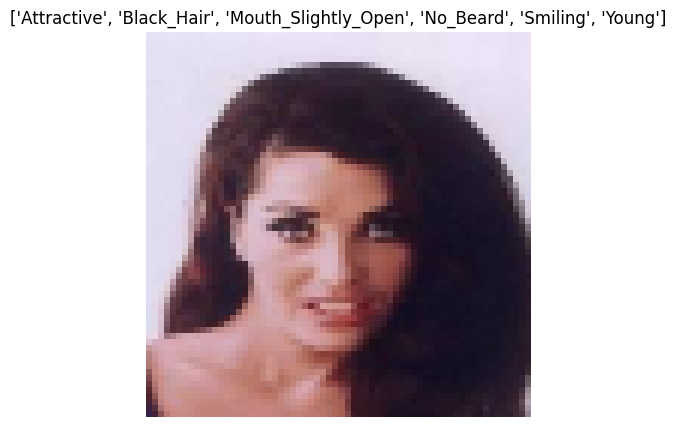

In [17]:
display(sample_batch(dataset), cmap=None, n=1)

In [45]:
# Define a custom dataset
class CelebADataset(Dataset):
    def __init__(self, img_dir, attr_file, transform=None):
        self.img_dir = img_dir
        self.transform = transform
        self.attrs = pd.read_csv(attr_file)
        self.img_names = self.attrs['image_id']
        self.attrs = self.attrs.drop('image_id', axis=1).values

    def __len__(self):
        return len(self.img_names)

    def __getitem__(self, idx):
        img_name = os.path.join(self.img_dir, str(self.img_names[idx]))
        image = Image.open(img_name)
        if self.transform:
            image = self.transform(image)
        attrs = torch.tensor(self.attrs[idx, :], dtype=torch.float32)
        return image, attrs

# Define the transformations
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
])

data_dir = os.getcwd()
images_dir = os.path.join(data_dir, 'img_align_celeba\img_align_celeba')
attributes_path = os.path.join(data_dir, 'list_attr_celeba.csv')
celeba_dataset = CelebADataset(img_dir=images_dir, attr_file=attributes_path, transform=transform)
# # Specify the proportion of the dataset to use (e.g., 10%)
# proportion = 0.001
# subset_size = int(proportion * len(celeba_dataset))
# remaining_size = len(celeba_dataWset) - subset_size

# # Split the dataset into the subset and the remaining part
# subset, _ = random_split(celeba_dataset, [subset_size, remaining_size])
batch_size = 64
dataloader = DataLoader(celeba_dataset, batch_size=batch_size, shuffle=True)

In [46]:
class Generator(nn.Module):
    def __init__(self, nz, nc, ngf, n_attr):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            nn.Linear(nz + n_attr, ngf * 8 * 4 * 4),
            nn.BatchNorm1d(ngf * 8 * 4 * 4),
            nn.ReLU(True),
            nn.Unflatten(1, (ngf * 8, 4, 4)),
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1),
            nn.Tanh()
        )

    def forward(self, noise, attrs):
        x = torch.cat([noise, attrs], 1)
        return self.main(x)

class Discriminator(nn.Module):
    def __init__(self, nc, ndf, n_attr):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(nc + n_attr, ndf, 4, 2, 1),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 8, 1, 4, 1, 0),
            nn.Sigmoid()
        )

    def forward(self, img, attrs):
        attr_map = attrs.unsqueeze(2).unsqueeze(3).expand(attrs.size(0), attrs.size(1), img.size(2), img.size(3))
        x = torch.cat([img, attr_map], 1)
        return self.main(x).view(-1, 1).squeeze(1)


# class Generator(nn.Module):
#     def __init__(self, nz, nc, ngf, n_attr):
#         super(Generator, self).__init__()
#         self.fc = nn.Sequential(
#             nn.Linear(nz + n_attr, ngf * 8 * 4 * 4),
#             nn.BatchNorm1d(ngf * 8 * 4 * 4),
#             nn.ReLU(True)
#         )
#         self.main = nn.Sequential(
#             nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1),
#             nn.BatchNorm2d(ngf * 4),
#             nn.ReLU(True),
#             nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1),
#             nn.BatchNorm2d(ngf * 2),
#             nn.ReLU(True),
#             nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1),
#             nn.BatchNorm2d(ngf),
#             nn.ReLU(True),
#             nn.ConvTranspose2d(ngf, nc, 4, 2, 1),
#             nn.Tanh()
#         )

#     def forward(self, noise, attrs):
#         x = torch.cat([noise, attrs], 1)
#         x = self.fc(x)
#         x = x.view(x.size(0), -1, 4, 4)
#         return self.main(x)


# class Discriminator(nn.Module):
#     def __init__(self, nc, ndf, n_attr):
#         super(Discriminator, self).__init__()
#         self.main = nn.Sequential(
#             nn.Conv2d(nc + n_attr, ndf, 4, 2, 1),
#             nn.LeakyReLU(0.2, inplace=True),
#             nn.Conv2d(ndf, ndf * 2, 4, 2, 1),
#             nn.BatchNorm2d(ndf * 2),
#             nn.LeakyReLU(0.2, inplace=True),
#             nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1),
#             nn.BatchNorm2d(ndf * 4),
#             nn.LeakyReLU(0.2, inplace=True),
#             nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1),
#             nn.BatchNorm2d(ndf * 8),
#             nn.LeakyReLU(0.2, inplace=True),
#             nn.Conv2d(ndf * 8, 1, 4, 1, 0),
#         )

#     def forward(self, img, attrs):
#         attr_map = attrs.unsqueeze(2).unsqueeze(3).expand(attrs.size(0), attrs.size(1), img.size(2), img.size(3))
#         x = torch.cat([img, attr_map], 1)
#         return self.main(x).view(-1, 1).squeeze(1)


In [47]:
# Hyperparameters
nz = 100  # Size of the latent vector
nc = 3    # Number of channels in the training images
ngf = 64  # Size of feature maps in generator
ndf = 64  # Size of feature maps in discriminator
n_attr = 40  # Number of attributes

device = torch.device("cuda")

# Initialize models
netG = Generator(nz, nc, ngf, n_attr).to(device)
netD = Discriminator(nc, ndf, n_attr).to(device)

# Loss function and optimizers
lr = 0.0002
criterion = nn.BCELoss()
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(0.5, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(0.5, 0.999))

# Training loop
num_epochs = 30

In [48]:
wandb.init(
    # set the wandb project where this run will be logged
    project="c-GANalyzer-celebA",

    # track hyperparameters and run metadata
    config={
    "learning_rate": lr,
    "architecture": "c-GAN",
    "dataset": "celebA",
    "epochs": num_epochs,
    "batch_size": batch_size,
    }
)

In [49]:
feature_map = {feature: i for i, feature in enumerate(features)}
# Function to create a tensor of attributes from a list of feature names
def get_attr_tensor(feature_names):
    attr_tensor = torch.zeros(1, n_attr)
    for feature in feature_names:
        attr_tensor[0, feature_map[feature]] = 1
    return attr_tensor.repeat(16,1).to(device)

In [50]:
sample_attrs = get_attr_tensor(['Male', 'Smiling', 'Eyeglasses', 'Young'])

In [51]:
def show_g_imgs(nz,device,netG,sample_attrs):
    # Generate random noise vectors
    noise = torch.randn(16, nz, device=device)

    # Generate images using the generator
    with torch.no_grad():
        generated_imgs = netG(noise, sample_attrs).cpu()

    # Visualize generated images
    fig, axes = plt.subplots(4, 4, figsize=(8, 8))
    for i, ax in enumerate(axes.flatten()):
        ax.imshow((generated_imgs[i].permute(1, 2, 0) + 1) / 2)
        ax.axis('off')
    plt.tight_layout()
    plt.show()

In [52]:
# Initialize FID metric
fid_metric = torchmetrics.image.fid.FrechetInceptionDistance().to(device)
#fid_metric = torchmetrics.image.FID()

def compute_fid(real_images, fake_images):
    fid_metric.update(real_images, real=True)
    fid_metric.update(fake_images, real=False)
    fid_score = fid_metric.compute()
    fid_metric.reset()
    return fid_score.item()

Epoch [1/30] D Loss: 0.884099543094635 G Loss: 3.266008138656616 D Accuracy: 0.7503788271412988 FID: 158.8810577392578


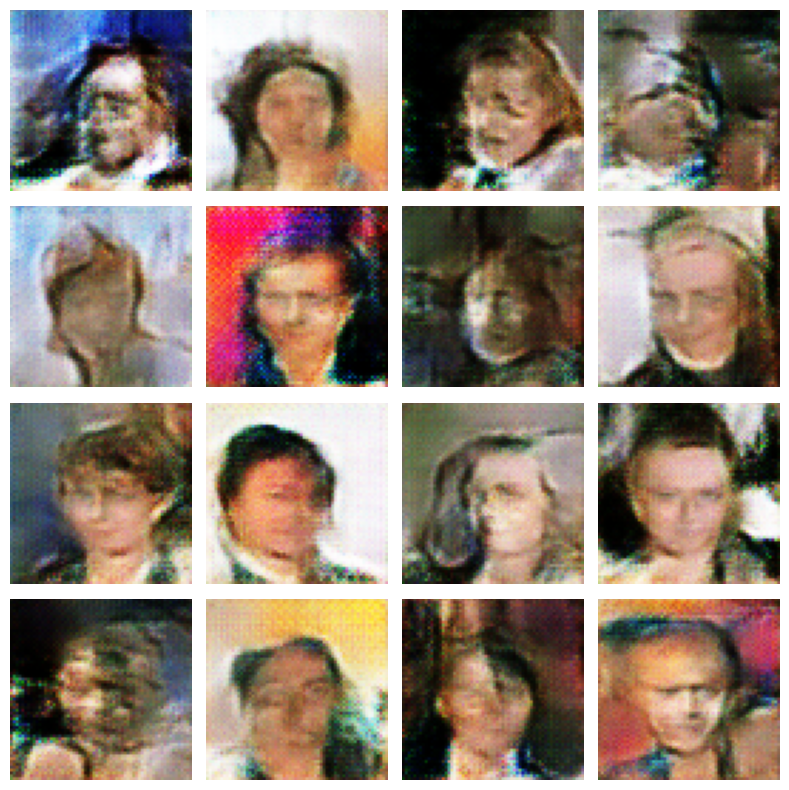

Epoch [2/30] D Loss: 0.3956856429576874 G Loss: 2.9786882400512695 D Accuracy: 0.8241871874984575 FID: 93.49466705322266


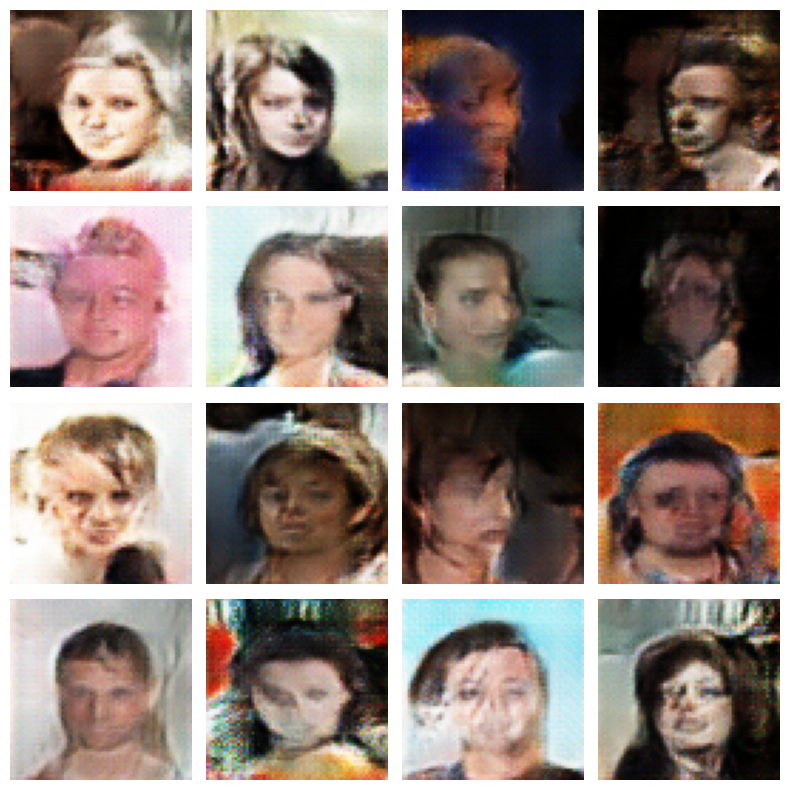

Epoch [3/30] D Loss: 0.5173515826463699 G Loss: 3.201066493988037 D Accuracy: 0.837716375697807 FID: 72.50521087646484


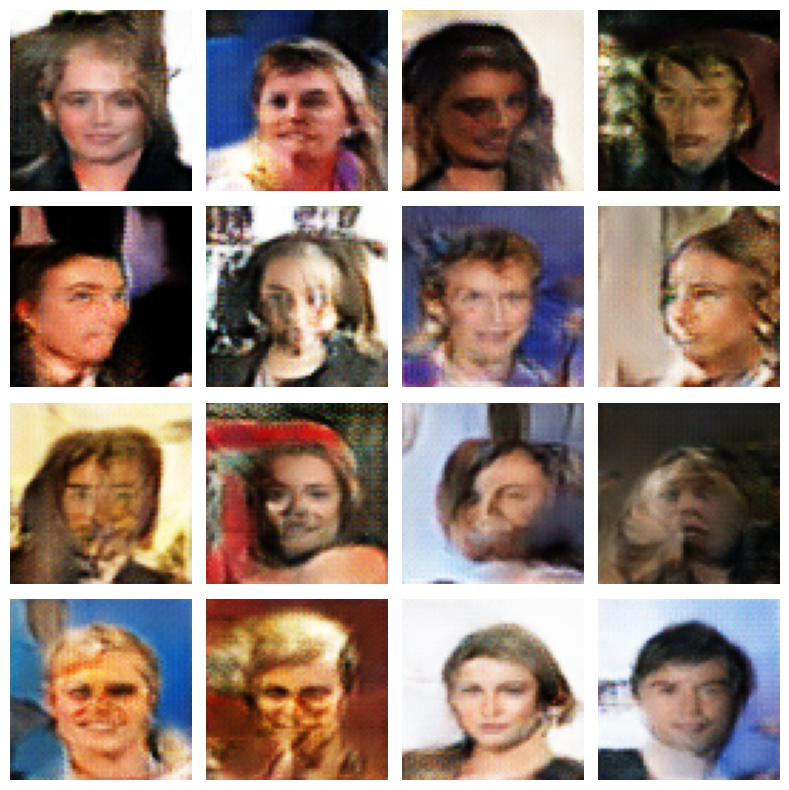

Epoch [4/30] D Loss: 0.41297271847724915 G Loss: 3.7430474758148193 D Accuracy: 0.8604089852368472 FID: 60.88407897949219


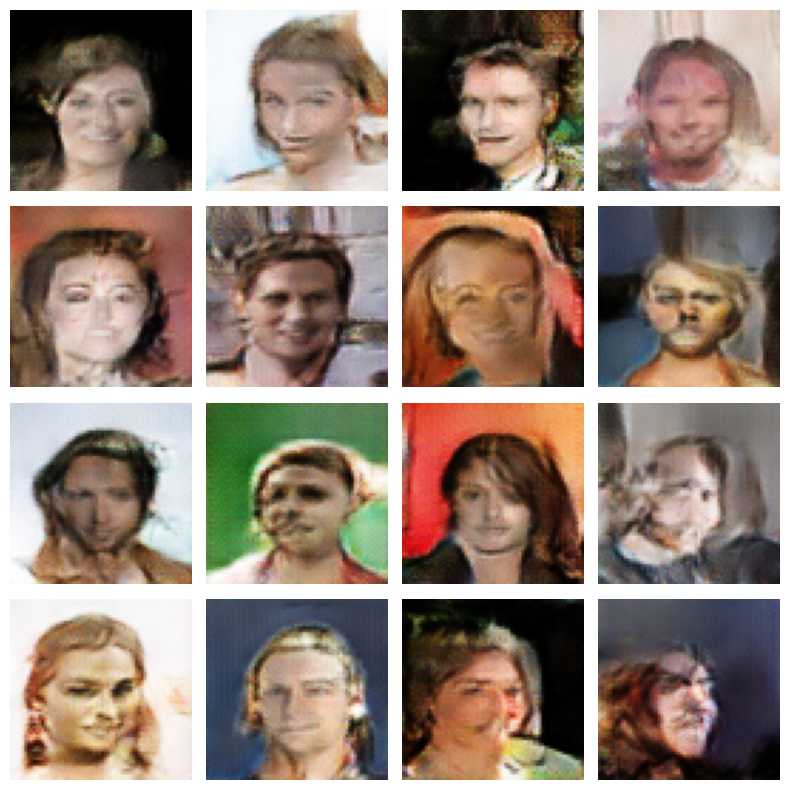

Epoch [5/30] D Loss: 0.4769466817378998 G Loss: 2.789855718612671 D Accuracy: 0.8774426329843681 FID: 51.995235443115234


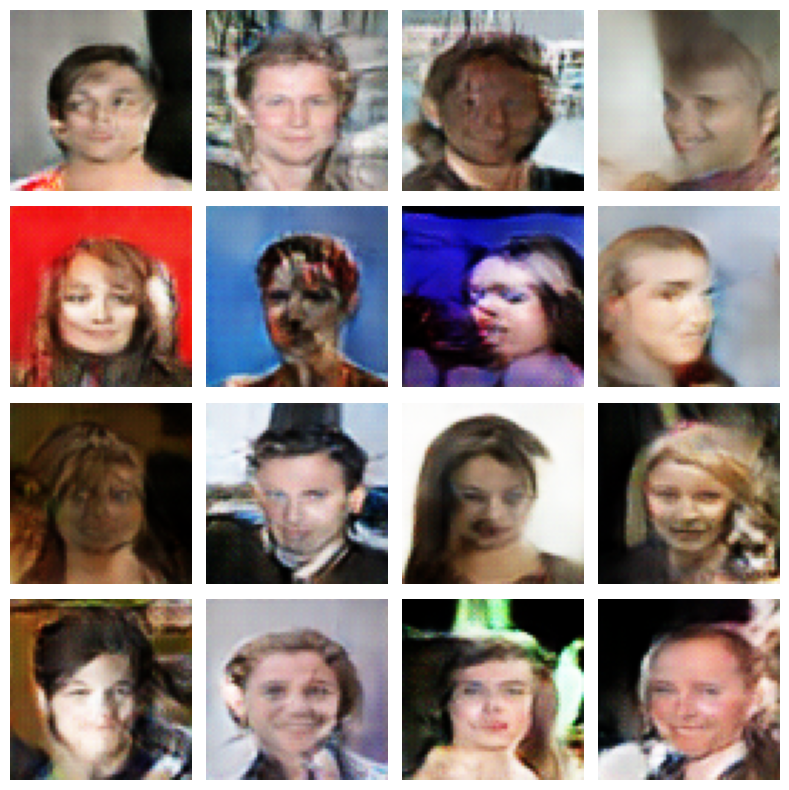

Epoch [6/30] D Loss: 0.599223181605339 G Loss: 1.8204741477966309 D Accuracy: 0.8899081436729698 FID: 45.414100646972656


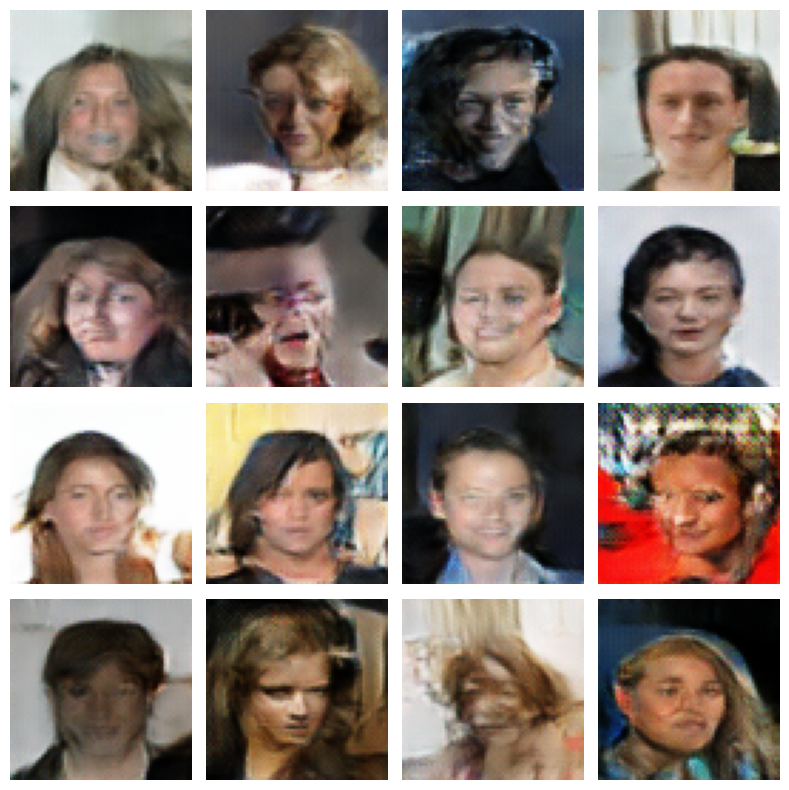

Epoch [7/30] D Loss: 0.426994264125824 G Loss: 2.489919900894165 D Accuracy: 0.9034916263160233 FID: 40.72367858886719


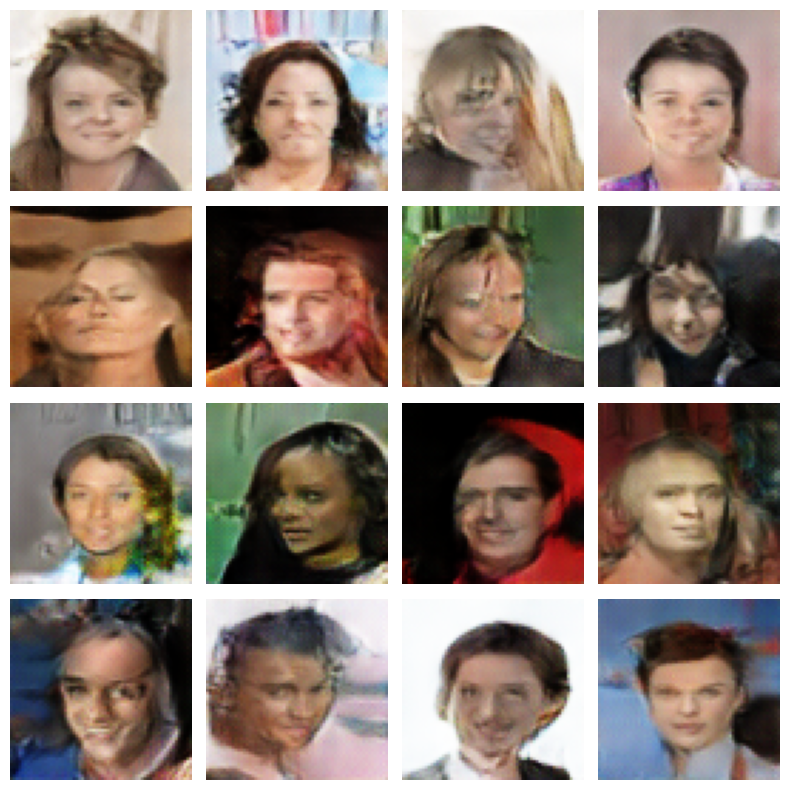

Epoch [8/30] D Loss: 0.8427897645160556 G Loss: 1.3822274208068848 D Accuracy: 0.9147972102527653 FID: 37.8161506652832


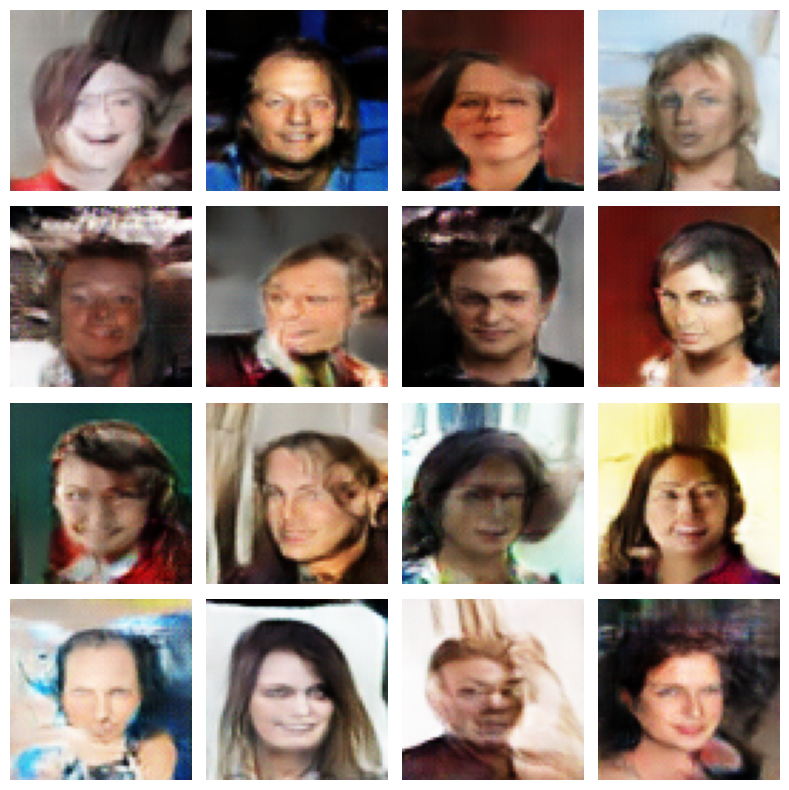

Epoch [9/30] D Loss: 0.3874255046248436 G Loss: 4.991192817687988 D Accuracy: 0.9248811692061659 FID: 35.39704895019531


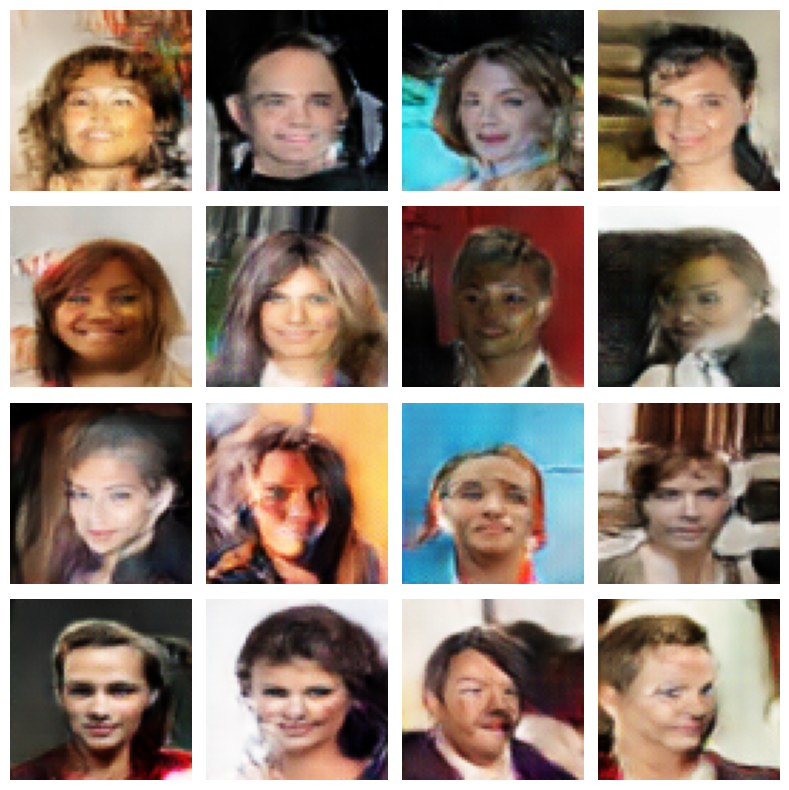

Epoch [10/30] D Loss: 0.3446357250213623 G Loss: 2.505516529083252 D Accuracy: 0.9323195079936228 FID: 33.773250579833984


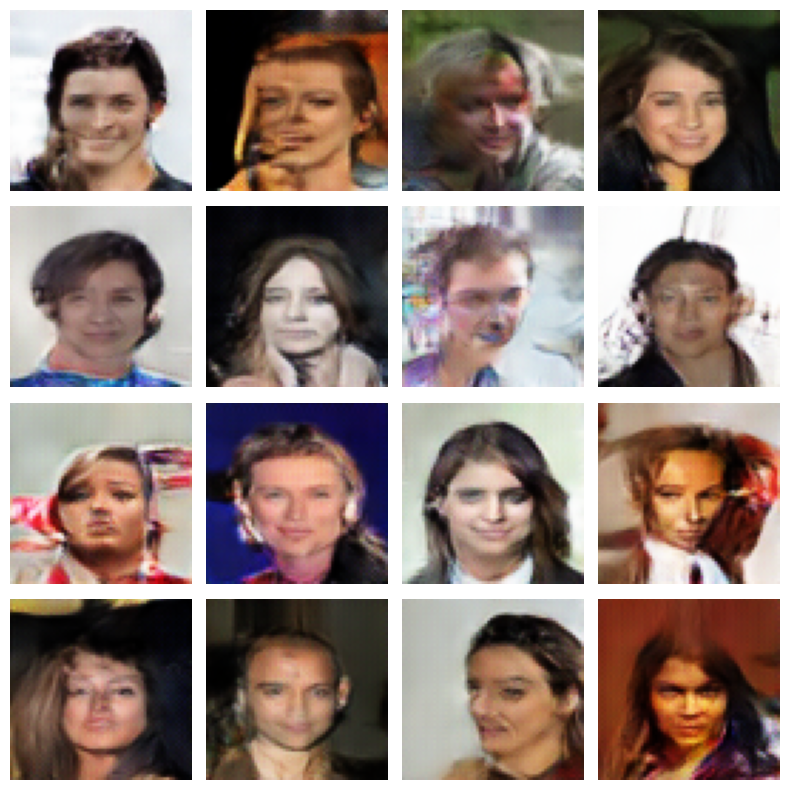

Epoch [11/30] D Loss: 0.34022413194179535 G Loss: 5.210840702056885 D Accuracy: 0.9365051160173545 FID: 32.32221221923828


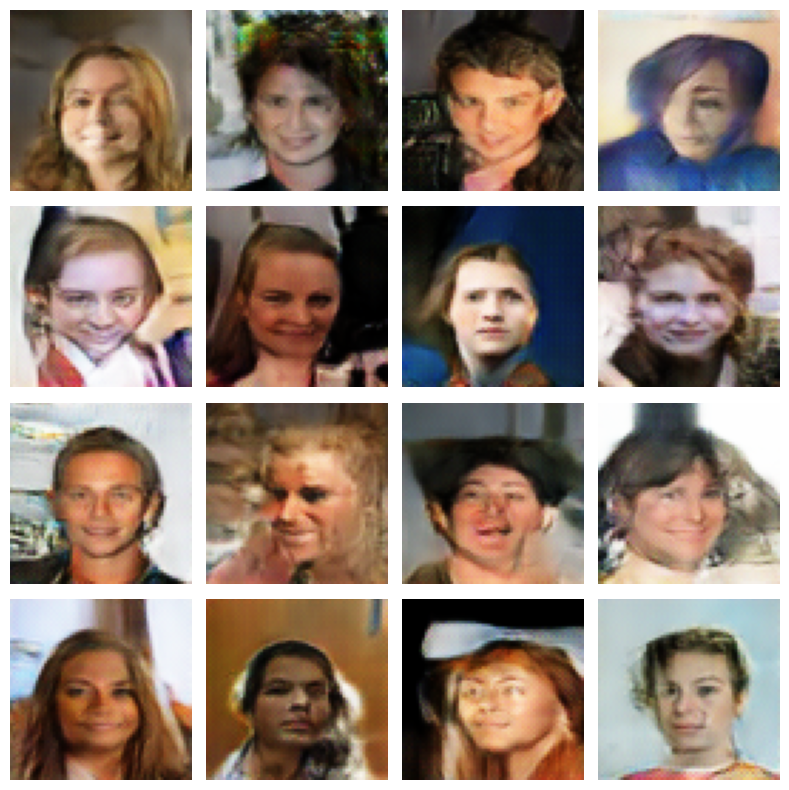

Epoch [12/30] D Loss: 0.6055609062314034 G Loss: 8.470108985900879 D Accuracy: 0.9400268510703409 FID: 31.28031349182129


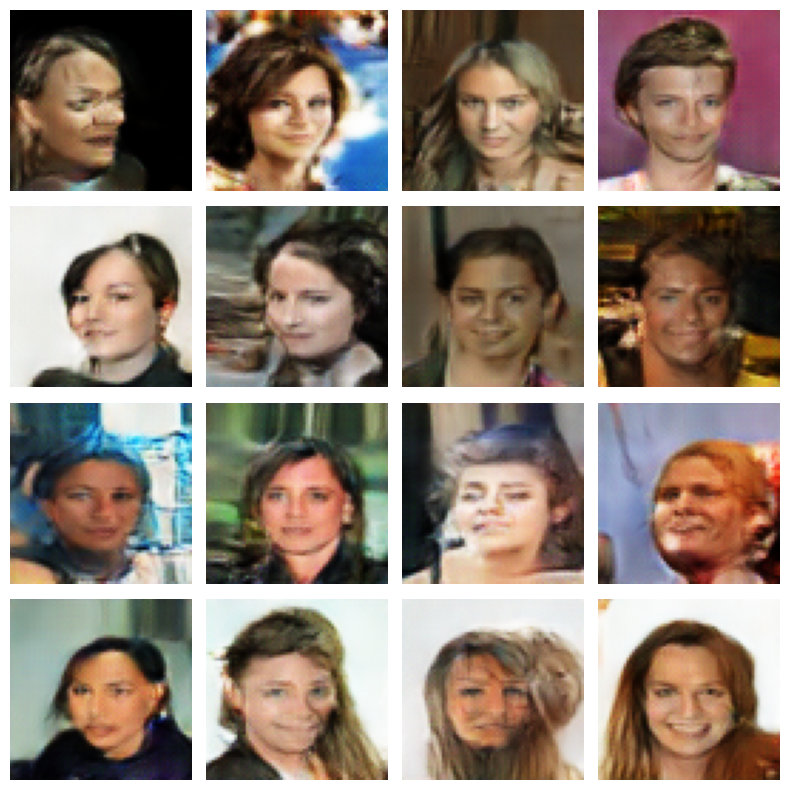

Epoch [13/30] D Loss: 0.12005984596908092 G Loss: 5.198317050933838 D Accuracy: 0.9459548171511212 FID: 30.30282211303711


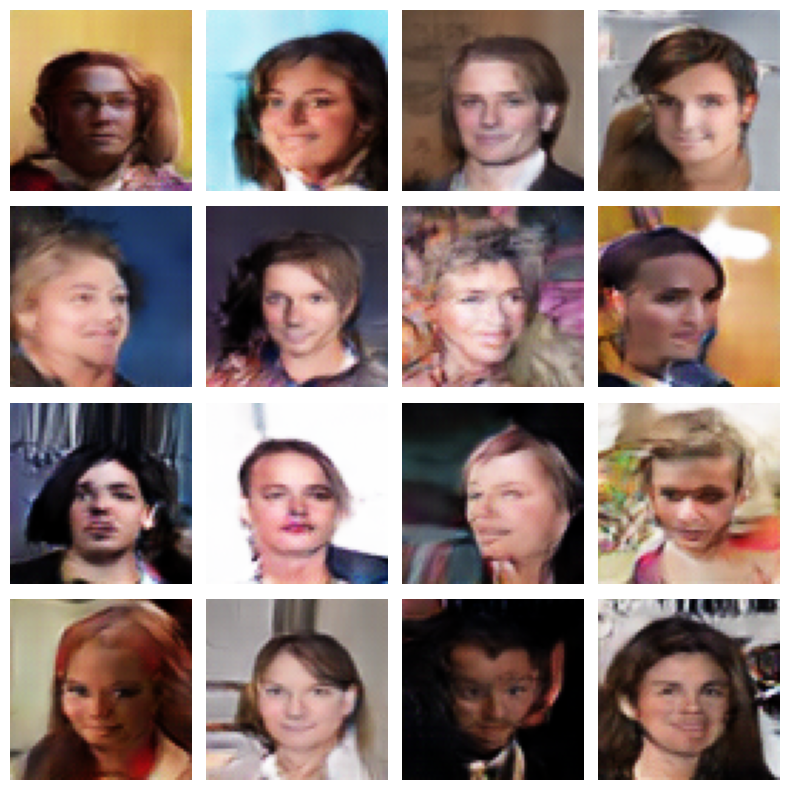

Epoch [14/30] D Loss: 0.2531820759177208 G Loss: 6.529076099395752 D Accuracy: 0.9511103213737482 FID: 29.135560989379883


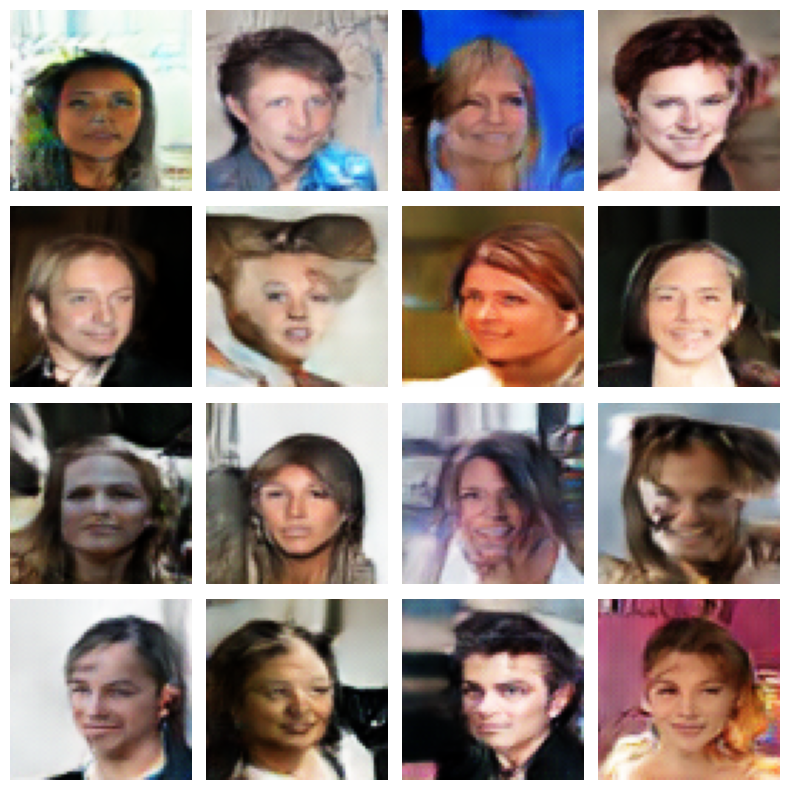

Epoch [15/30] D Loss: 0.28760476410388947 G Loss: 3.741978168487549 D Accuracy: 0.9513472425826386 FID: 28.433237075805664


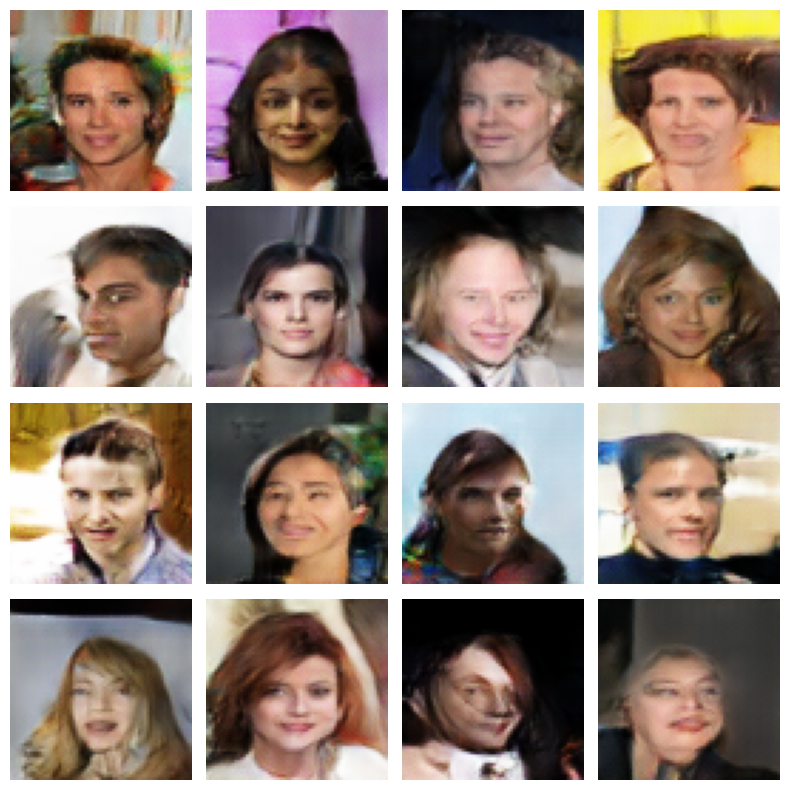

Epoch [16/30] D Loss: 0.07875711284577847 G Loss: 5.169958114624023 D Accuracy: 0.955083687481182 FID: 28.533058166503906


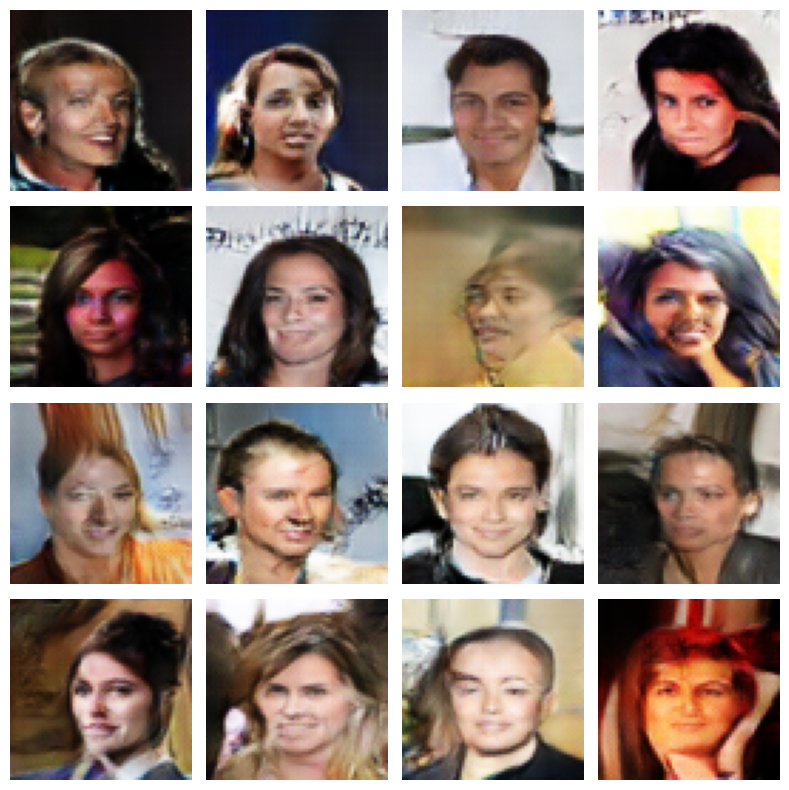

Epoch [17/30] D Loss: 0.12459937855601311 G Loss: 4.740477561950684 D Accuracy: 0.9602342558452904 FID: 27.96442222595215


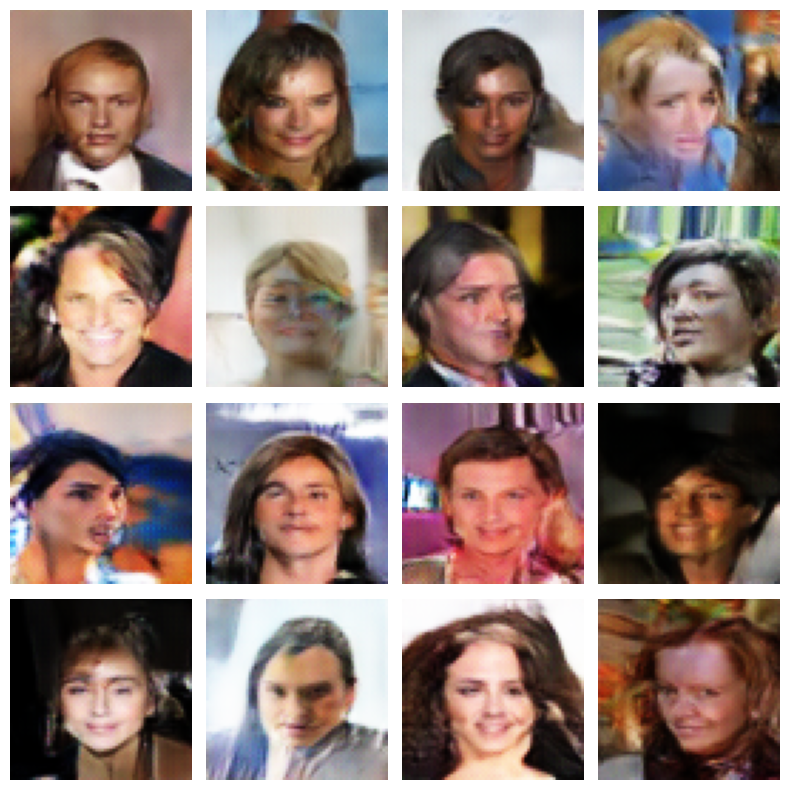

Epoch [18/30] D Loss: 0.05794325843453407 G Loss: 5.013702392578125 D Accuracy: 0.9569173589208239 FID: 27.373849868774414


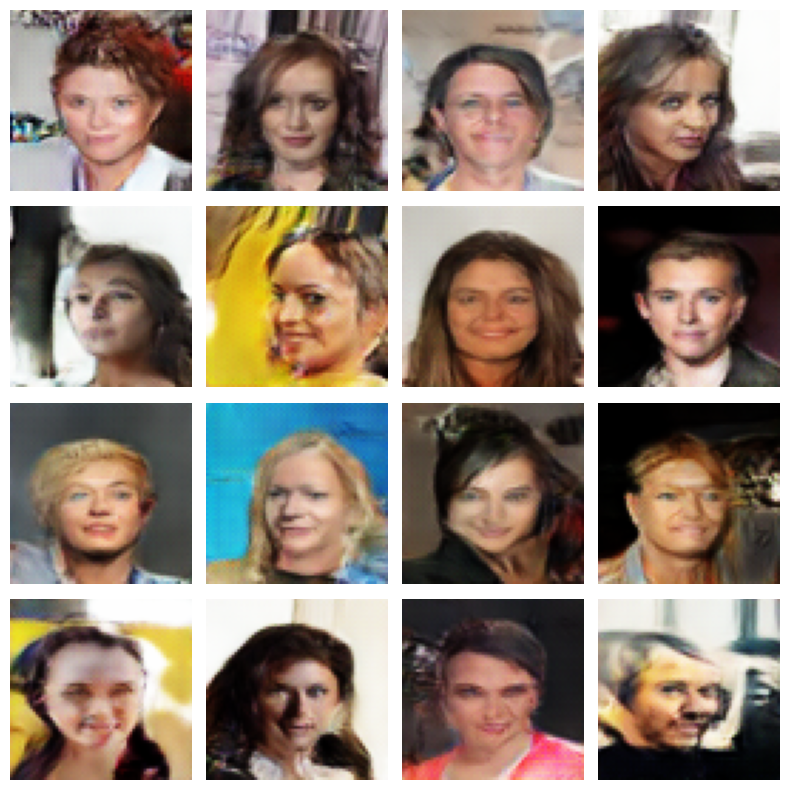

Epoch [19/30] D Loss: 0.2642028480768204 G Loss: 6.585144996643066 D Accuracy: 0.9572431255830482 FID: 26.372079849243164


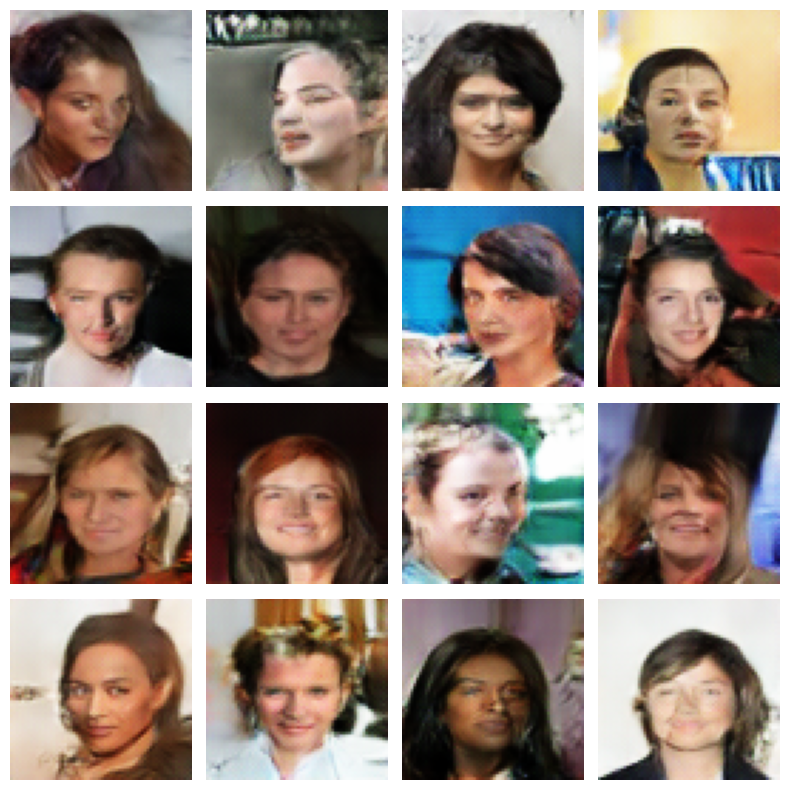

Epoch [20/30] D Loss: 0.18443516455590725 G Loss: 5.820224285125732 D Accuracy: 0.96599440273644 FID: 26.77661895751953


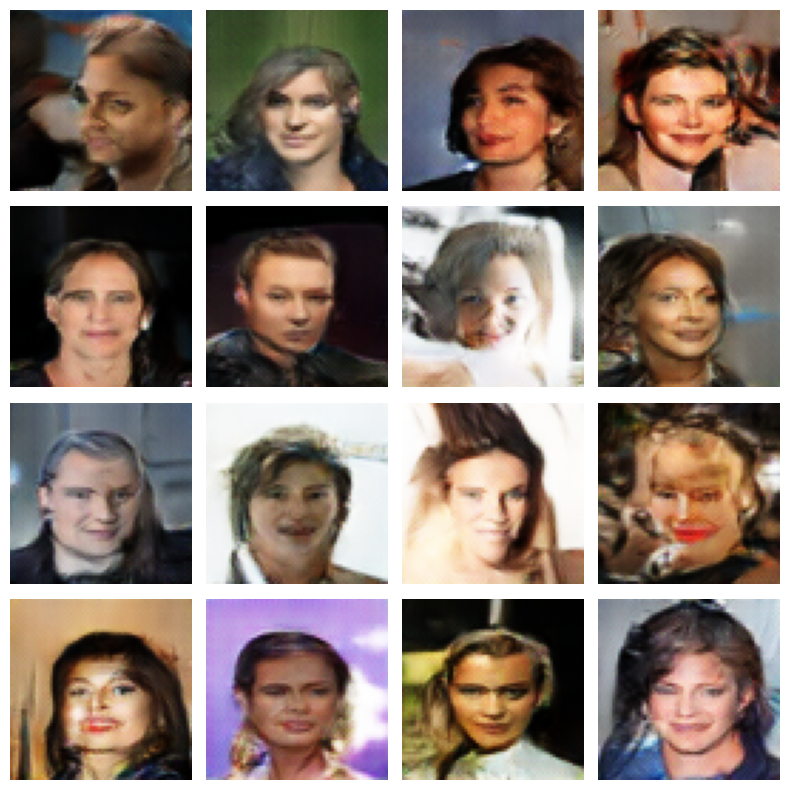

Epoch [21/30] D Loss: 0.6849620100110769 G Loss: 5.753701210021973 D Accuracy: 0.9621765161723405 FID: 26.10982894897461


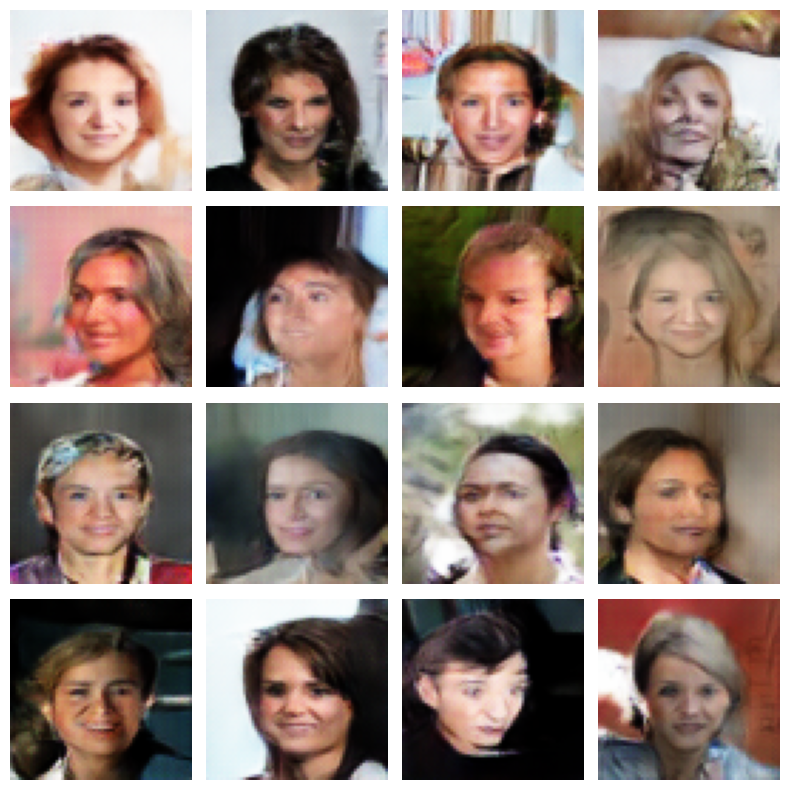

Epoch [22/30] D Loss: 0.24368255492299795 G Loss: 3.8947386741638184 D Accuracy: 0.9633166994901258 FID: 26.168914794921875


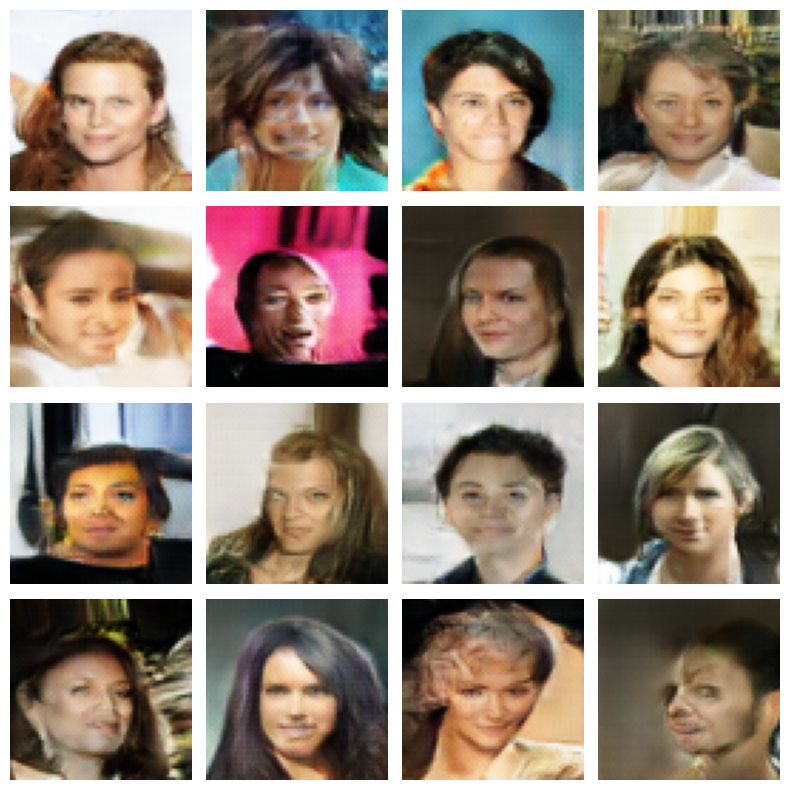

Epoch [23/30] D Loss: 0.49772923812270164 G Loss: 1.6523821353912354 D Accuracy: 0.9667397173727412 FID: 25.888168334960938


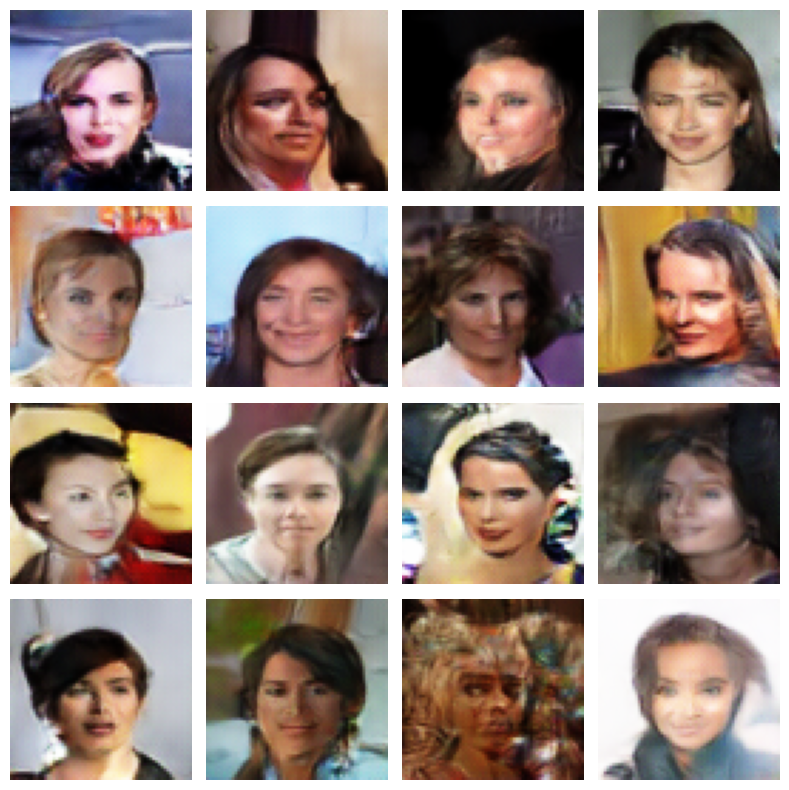

Epoch [24/30] D Loss: 0.3100223019719124 G Loss: 3.672447919845581 D Accuracy: 0.9648418797723582 FID: 25.56803321838379


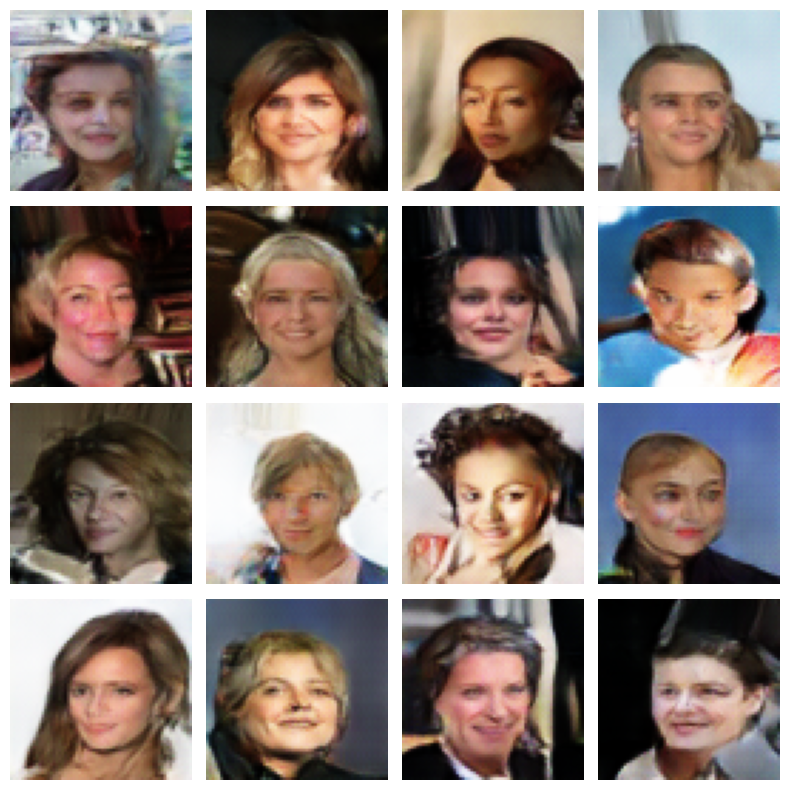

Epoch [25/30] D Loss: 0.1608005240559578 G Loss: 6.130976676940918 D Accuracy: 0.9703552337375801 FID: 25.700864791870117


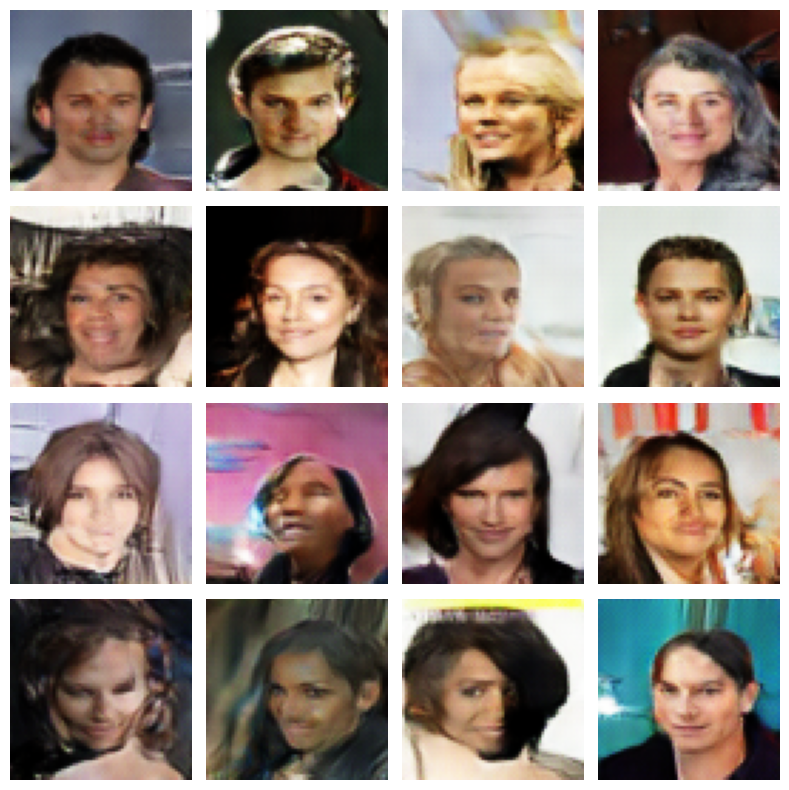

KeyboardInterrupt: 

In [54]:
for epoch in range(num_epochs):
    d_total_accuracy = 0
    total_samples = 0

    # Reset FID metric at the start of each epoch
    fid_metric.reset()

    for i, (images, attrs) in enumerate(dataloader):
        batch_size = images.size(0)
        real_imgs = images.to(device)
        attrs = attrs.to(device)

        # Labels for real and fake images
        real_labels = torch.ones(batch_size, device=device)
        fake_labels = torch.zeros(batch_size, device=device)

        # Train Discriminator
        optimizerD.zero_grad()
        outputs = netD(real_imgs, attrs).squeeze()
        assert outputs.shape == real_labels.shape, f"Shape mismatch: outputs {outputs.shape}, real_labels {real_labels.shape}"
        d_loss_real = criterion(outputs, real_labels)
        d_loss_real.backward()

        noise = torch.randn(batch_size, nz, device=device)
        fake_imgs = netG(noise, attrs)
        outputs_fake = netD(fake_imgs.detach(), attrs).squeeze()
        assert outputs_fake.shape == fake_labels.shape, f"Shape mismatch: outputs_fake {outputs_fake.shape}, fake_labels {fake_labels.shape}"
        d_loss_fake = criterion(outputs_fake, fake_labels)
        d_loss_fake.backward()
        optimizerD.step()

        # Calculate Discriminator Accuracy
        with torch.no_grad():
            preds_real = (outputs >= 0.5).float()
            preds_fake = (outputs_fake < 0.5).float()
            d_total_accuracy += (preds_real.sum() + preds_fake.sum()).item()
            total_samples += batch_size * 2  # since we have both real and fake samples

        # Train Generator
        optimizerG.zero_grad()
        outputs = netD(fake_imgs, attrs).squeeze()
        assert outputs.shape == real_labels.shape, f"Shape mismatch: outputs {outputs.shape}, real_labels {real_labels.shape}"
        g_loss = criterion(outputs, real_labels)
        g_loss.backward()
        optimizerG.step()

        # Update FID metric with current batch
        real_imgs_uint8 = real_imgs.mul(255).byte()
        fake_imgs_uint8 = fake_imgs.mul(255).byte()
        fid_metric.update(real_imgs_uint8, real=True)
        fid_metric.update(fake_imgs_uint8, real=False)

    # Compute FID
    fid_score = fid_metric.compute().item()

    d_accuracy = d_total_accuracy / total_samples
    print(f'Epoch [{epoch+1}/{num_epochs}] D Loss: {d_loss_real.item() + d_loss_fake.item()} G Loss: {g_loss.item()} D Accuracy: {d_accuracy} FID: {fid_score}')

    wandb.log({
        "D Loss": d_loss_real.item() + d_loss_fake.item(),
        "G Loss": g_loss.item(),
        "D Accuracy": d_accuracy,
        "FID": fid_score
    })

    show_g_imgs(nz, device, netG, sample_attrs)

wandb.finish()

## Saving the model - W&B Artifacts 

In [55]:
G_path = "generator.pth"
D_path = "discriminator.pth"
with wandb.init(project="c-GANalyzer-celebA") as run:
    model_artifact = wandb.Artifact(
        "trained-model", type="model",
        description="Trained c-GAN model")
    torch.save(netG.state_dict(), G_path)
    torch.save(netD.state_dict(), D_path)
    model_artifact.add_file(G_path)
    model_artifact.add_file(D_path)
    run.log_artifact(model_artifact)
wandb.finish()


D Accuracy,▁▃▄▅▅▅▆▆▇▇▇▇▇▇▇██████████
D Loss,█▄▅▄▅▆▄█▄▃▃▆▂▃▃▁▂▁▃▂▆▃▅▃▂
FID,█▅▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
G Loss,▃▃▃▃▂▁▂▁▅▂▅█▅▆▃▅▄▅▆▅▅▃▁▃▆
D Accuracy,0.97036
D Loss,0.1608
FID,25.70086
G Loss,6.13098


## Loading the model

In [56]:
api = wandb.Api()
model_artifact = api.artifact('348612/c-GANalyzer-celebA/trained-model:latest', type='model')
model_dir = model_artifact.download()
netG_path = os.path.join(model_dir, G_path)
netD_path = os.path.join(model_dir, D_path)
netG = Generator(nz, nc, ngf, n_attr).to(device)
netD = Discriminator(nc, ndf, n_attr).to(device)
netG.load_state_dict(torch.load(G_path))
netD.load_state_dict(torch.load(D_path))

wandb:   2 of 2 files downloaded.  


<All keys matched successfully>

In [57]:
feature_map = {feature: i for i, feature in enumerate(features)}

In [58]:
# Function to create a tensor of attributes from a list of feature names
def get_attr_tensor(feature_names):
    attr_tensor = torch.zeros(1, n_attr)
    for feature in feature_names:
        attr_tensor[0, feature_map[feature]] = 1
    return attr_tensor.repeat(16,1).to(device)

In [59]:
feature_map

{'5_o_Clock_Shadow': 0,
 'Arched_Eyebrows': 1,
 'Attractive': 2,
 'Bags_Under_Eyes': 3,
 'Bald': 4,
 'Bangs': 5,
 'Big_Lips': 6,
 'Big_Nose': 7,
 'Black_Hair': 8,
 'Blond_Hair': 9,
 'Blurry': 10,
 'Brown_Hair': 11,
 'Bushy_Eyebrows': 12,
 'Chubby': 13,
 'Double_Chin': 14,
 'Eyeglasses': 15,
 'Goatee': 16,
 'Gray_Hair': 17,
 'Heavy_Makeup': 18,
 'High_Cheekbones': 19,
 'Male': 20,
 'Mouth_Slightly_Open': 21,
 'Mustache': 22,
 'Narrow_Eyes': 23,
 'No_Beard': 24,
 'Oval_Face': 25,
 'Pale_Skin': 26,
 'Pointy_Nose': 27,
 'Receding_Hairline': 28,
 'Rosy_Cheeks': 29,
 'Sideburns': 30,
 'Smiling': 31,
 'Straight_Hair': 32,
 'Wavy_Hair': 33,
 'Wearing_Earrings': 34,
 'Wearing_Hat': 35,
 'Wearing_Lipstick': 36,
 'Wearing_Necklace': 37,
 'Wearing_Necktie': 38,
 'Young': 39}

In [60]:
sample_attrs = get_attr_tensor(['Arched_Eyebrows',
 'Attractive',
 'Brown_Hair',
 'Heavy_Makeup',
 'High_Cheekbones',
 'Mouth_Slightly_Open',
 'No_Beard',
 'Pointy_Nose',
 'Smiling',
 'Straight_Hair',
 'Wearing_Earrings',
 'Wearing_Lipstick',
 'Young'])

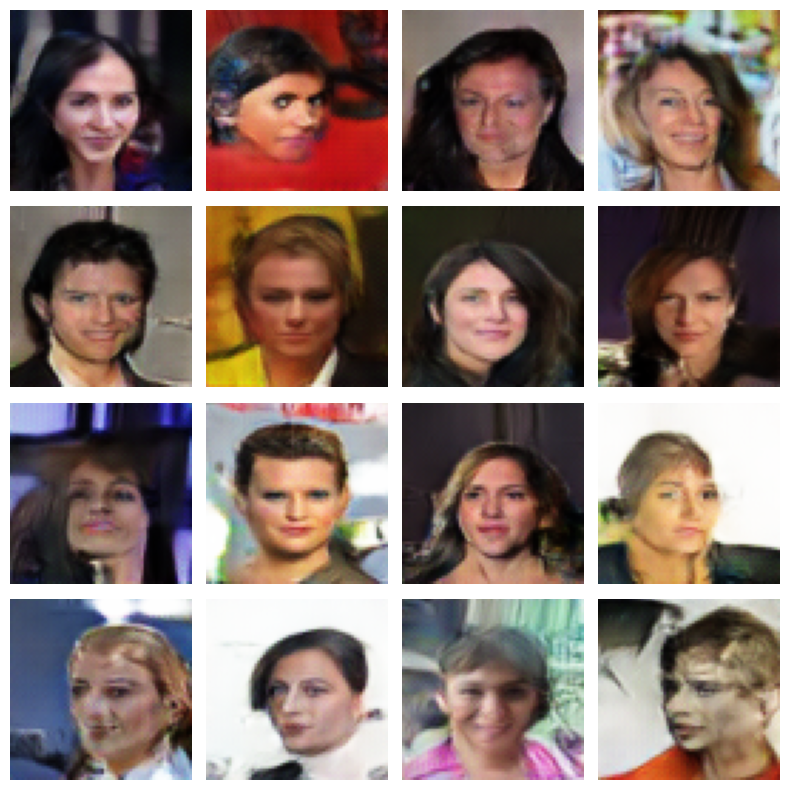

In [66]:
# Generate random noise vectors
noise = torch.randn(16, nz, device=device)

# Generate images using the generator
with torch.no_grad():
    generated_imgs = netG(noise, sample_attrs).cpu()

# Visualize generated images
fig, axes = plt.subplots(4, 4, figsize=(8, 8))
for i, ax in enumerate(axes.flatten()):
    ax.imshow((generated_imgs[i].permute(1, 2, 0) + 1) / 2)
    ax.axis('off')
plt.tight_layout()
plt.show()
